In [1]:
import pandas as pd
import numpy as np
import warnings
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from sklearn.decomposition import PCA

plt.rcParams.update({'font.size': 12})

clist = ['#de411b', '#0ac3e6', '#c31900', '#9BB4BE', '#379BD7', '#eb6961', '#233237', '#285078','#690505']
n_colors = len(clist)
rvb = mcolors.LinearSegmentedColormap.from_list("", clist)


dataset = pd.read_csv('datasets/experiments/cie10.csv')
dataset.head()

,AFEC_DPTO,AFEC_EDUC,AFEC_GENERO,AFEC_GETNICO,AFEC_MPIO,AFEC_PARENTESCO,AFEC_POBESPECIAL,AFEC_REGAFILIACION,AFEC_TIPOPER,ALTO_COSTO,...,PQR_TIPOPETICION,TRIM,CAPITULO,COD_CIE_10_03,COD_CIE_10_04,CIE10_SEXO,AFEC_EDADR_INF,AFEC_EDADR_SUP,CIE10_RANGO_EDAD,RIESGO_VIDA
0,0.425153,0.400555,0.458335,0.42859,0.454756,0.537595,0.532278,0.419117,0.431765,0.426038,...,0.455397,0.405202,0.420753,0.659895,0.795501,0.407151,0.436994,0.436994,0.413772,1
1,0.552813,0.436647,0.458335,0.42859,0.557585,0.537595,0.419145,0.419117,0.431765,0.426038,...,0.455397,0.405202,0.370675,0.203957,0.111111,0.407151,0.436994,0.436994,0.413772,0
2,0.491303,0.435185,0.458335,0.42859,0.485267,0.537595,0.419145,0.380646,0.431765,0.426038,...,0.455397,0.405202,0.453680,0.457447,0.466667,0.407151,0.436994,0.436994,0.413772,0
3,0.552813,0.400555,0.412468,0.42859,0.527363,0.426399,0.532278,0.419117,0.431765,0.426038,...,0.455397,0.405202,0.248912,0.529412,0.727259,0.407151,0.435873,0.435873,0.413772,1
4,0.411579,0.400555,0.458335,0.42859,0.401531,0.383166,0.419145,0.419117,0.431765,0.426038,...,0.455397,0.405202,0.311155,0.134942,0.130781,0.407151,0.435873,0.435873,0.413772,0


In [2]:
reduced_data = dataset.drop(['RIESGO_VIDA'], axis = 1)

pca = PCA(n_components=2)
pca = pca.fit(reduced_data)


reduced_data = pca.transform(reduced_data)
reduced_data = pd.DataFrame(reduced_data, columns = ['Dimension 1', 'Dimension 2'])
reduced_data['RIESGO_VIDA'] = dataset['RIESGO_VIDA']
reduced_data.head()

,Dimension 1,Dimension 2,RIESGO_VIDA
0,-0.368309,0.167402,1
1,0.236726,-0.393678,0
2,-0.008955,0.014160,0
3,-0.368125,-0.014891,1
4,0.308818,-0.258263,0


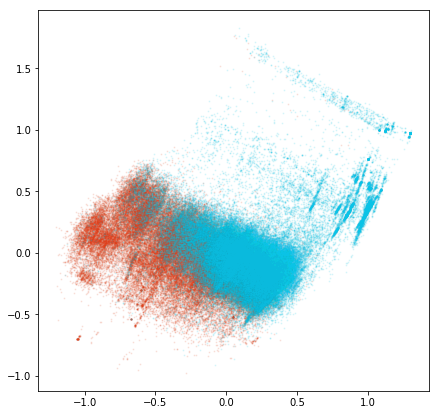

In [3]:
fig, ax = plt.subplots(figsize=(7, 7))

life_risk = reduced_data[reduced_data['RIESGO_VIDA'] == 1]
no_life_risk = reduced_data[reduced_data['RIESGO_VIDA'] == 0]
plt.scatter(life_risk['Dimension 1'], life_risk['Dimension 2'], alpha = 0.1, color = '#de411b', s=1)
plt.scatter(no_life_risk['Dimension 1'], no_life_risk['Dimension 2'], alpha = 0.1, color = '#0ac3e6',s=1)
plt.show()

In [9]:
reduced_data_3d = dataset.drop(['RIESGO_VIDA'], axis = 1)

pca = PCA(n_components=3)
pca = pca.fit(reduced_data_3d)


reduced_data_3d = pca.transform(reduced_data_3d)
reduced_data_3d = pd.DataFrame(reduced_data_3d, columns = ['Dimension 1', 'Dimension 2', 'Dimension 3'])
reduced_data_3d['RIESGO_VIDA'] = dataset['RIESGO_VIDA']
reduced_data_3d['RIESGO_VIDA'] = reduced_data_3d['RIESGO_VIDA'].apply(lambda value: '#de411b' if value == 1 else '#0ac3e6')
reduced_data_3d.head()

,Dimension 1,Dimension 2,Dimension 3,RIESGO_VIDA
0,-0.368309,0.167402,0.160390,#de411b
1,0.236726,-0.393678,0.230475,#0ac3e6
2,-0.008955,0.014160,0.097277,#0ac3e6
3,-0.368125,-0.014891,0.078050,#de411b
4,0.308818,-0.258263,-0.198393,#0ac3e6


In [11]:
import plotly.graph_objects as go
import numpy as np

# Helix equation
t = np.linspace(0, 20, 100)
x, y, z = np.cos(t), np.sin(t), t

fig = go.Figure(data=[go.Scatter3d(
    x=reduced_data_3d['Dimension 1'],
    y=reduced_data_3d['Dimension 2'], 
    z=reduced_data_3d['Dimension 3'],
    mode='markers',
    marker=dict(
        size=1,
        color=reduced_data_3d['RIESGO_VIDA'],                # set color to an array/list of desired values
        opacity=0.8
    )
)])

# tight layout
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()